In [1]:
## test min bound rectangle
import pandas as pd
import time
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import math
from scipy.spatial import distance

In [ ]:
# tsne-locations and mrna file are huge hence not posted on github

In [2]:
# location of the tsne coordinate file
df_subset = pd.read_csv("tsne_locations.csv",index_col=0)

In [3]:
df_subset.head()

,tsne-2d-one,tsne-2d-two
0,-108.791885,-9.764033
1,77.761060,43.576010
2,49.523230,40.580402
3,-18.878242,-28.076777
4,97.787310,30.879904


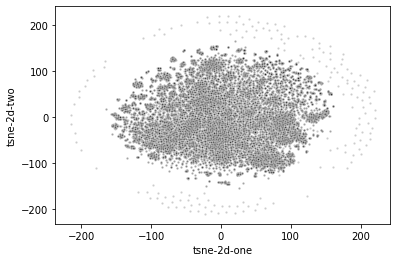

In [4]:
plot = sns.scatterplot(x="tsne-2d-one", y="tsne-2d-two",data=df_subset,alpha=0.2,s=5,color='k')
#plot = sns.scatterplot(x="umap-2d-one", y="umap-2d-two",data=df_subset,alpha=0.2,s=5,color='k')

In [8]:
def minimum_bounding_rectangle(points):
    """
    Find the smallest bounding rectangle for a set of points.
    Returns a set of points representing the corners of the bounding box.

    :param points: an nx2 matrix of coordinates
    :rval: an nx2 matrix of coordinates
    """
    from scipy.ndimage.interpolation import rotate
    pi2 = np.pi/2.

    # get the convex hull for the points
    hull_points = points[ConvexHull(points).vertices]

    # calculate edge angles
    edges = np.zeros((len(hull_points)-1, 2))
    edges = hull_points[1:] - hull_points[:-1]

    angles = np.zeros((len(edges)))
    angles = np.arctan2(edges[:, 1], edges[:, 0])

    angles = np.abs(np.mod(angles, pi2))
    angles = np.unique(angles)

    # find rotation matrices
    # XXX both work
    rotations = np.vstack([
        np.cos(angles),
        np.cos(angles-pi2),
        np.cos(angles+pi2),
        np.cos(angles)]).T
#     rotations = np.vstack([
#         np.cos(angles),
#         -np.sin(angles),
#         np.sin(angles),
#         np.cos(angles)]).T
    rotations = rotations.reshape((-1, 2, 2))

    # apply rotations to the hull
    rot_points = np.dot(rotations, hull_points.T)

    # find the bounding points
    min_x = np.nanmin(rot_points[:, 0], axis=1)
    max_x = np.nanmax(rot_points[:, 0], axis=1)
    min_y = np.nanmin(rot_points[:, 1], axis=1)
    max_y = np.nanmax(rot_points[:, 1], axis=1)

    # find the box with the best area
    areas = (max_x - min_x) * (max_y - min_y)
    best_idx = np.argmin(areas)

    # return the best box
    x1 = max_x[best_idx]
    x2 = min_x[best_idx]
    y1 = max_y[best_idx]
    y2 = min_y[best_idx]
    r = rotations[best_idx]

    rval = np.zeros((4, 2))
    rval[0] = np.dot([x1, y2], r)
    rval[1] = np.dot([x2, y2], r)
    rval[2] = np.dot([x2, y1], r)
    rval[3] = np.dot([x1, y1], r)

    return rval

(-317.6436803003522,
 331.13351930499516,
 -319.9981096547172,
 331.23846622890744)

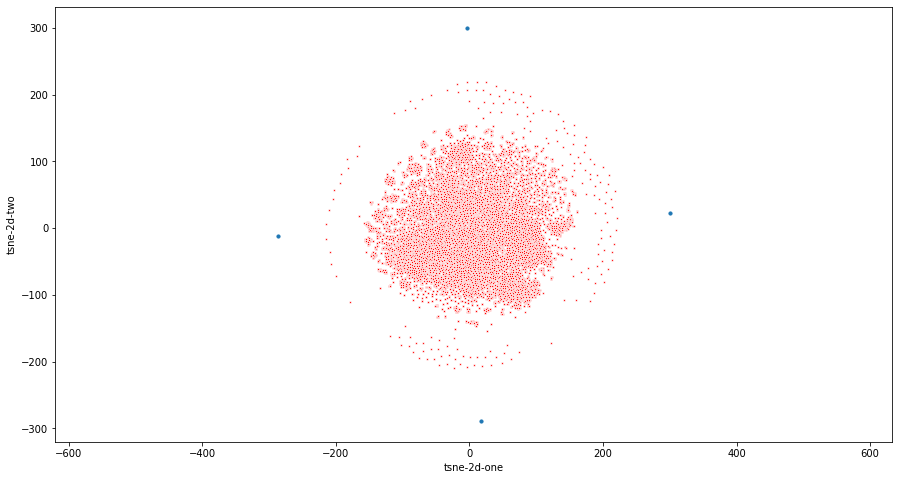

In [9]:
mbr = minimum_bounding_rectangle(df_subset.values)
plt.figure(figsize=(15,8))
sns.scatterplot(x="tsne-2d-one", y="tsne-2d-two",data=df_subset,alpha=0.9,s=5,color='r')
#sns.scatterplot(x="umap-2d-one", y="umap-2d-two",data=df_subset,alpha=0.9,s=5,color='r')
plt.scatter(mbr[:,0], mbr[:,1],s=10)
plt.axis('equal')
#plt.scatter(df_subset.values[:,0], df_subset.values[:,1])

In [10]:

print(mbr)
y2,y1,x2,x1 = mbr[0][1],mbr[1][1],mbr[0][0],mbr[1][0]
theta = (y2-y1)/(x2-x1)
angle  = math.degrees(np.arctan(theta))
angle  = np.arctan(theta)
#r_angle
r_matrix = np.asarray([[math.cos(angle),-1*math.sin(angle)],[math.sin(angle),math.cos(angle)]])
#rotation matrix
r_matrix


[[ 300.73788106   22.53064854]
 [  16.95560657 -288.68165202]
 [-287.24804206  -11.29029196]
 [  -3.46576757  299.92200859]]


array([[ 0.6737926 , -0.73892052],
       [ 0.73892052,  0.6737926 ]])

In [11]:
zrect = np.matmul(mbr,r_matrix) # ??? correct 
#zrect
z = np.asarray(np.matmul(df_subset,r_matrix))

rz_subset  = pd.DataFrame()
rz_subset['rot-tsne-2d-one'] = z[:,0]
rz_subset['rot-tsne-2d-two'] = z[:,1]
rz_subset

,rot-tsne-2d-one,rot-tsne-2d-two
0,-80.518011,73.809623
1,84.594035,-28.098050
2,63.354078,-9.250956
3,-33.466526,-4.968404
4,88.706161,-51.450399
...,...,...
20167,23.847934,-52.659464
20168,-1.114870,30.096686
20169,-13.277914,82.949468
20170,-47.818454,-90.394237


(-225.06477374914985,
 242.45985755098607,
 -229.43590215932005,
 227.04165242021276)

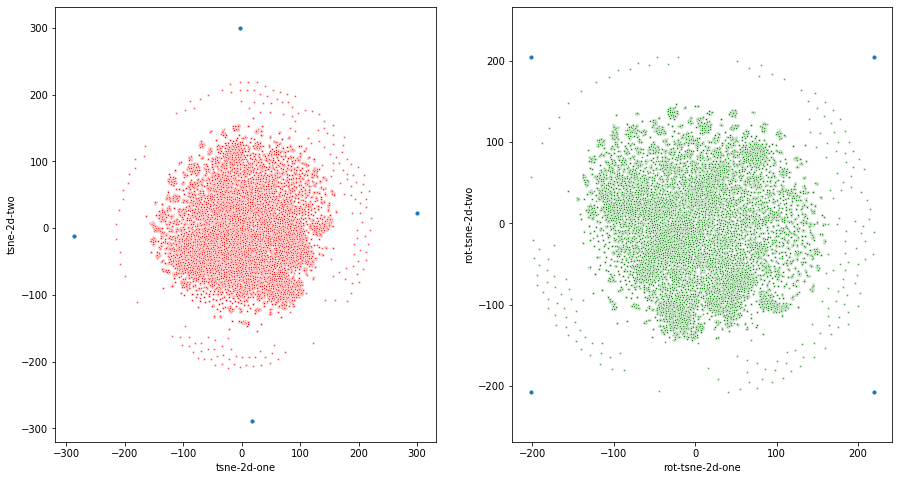

In [12]:
#plots original and rotated data
plt.figure(figsize=(15,8))
plt.subplot(121)
sns.scatterplot(x="tsne-2d-one", y="tsne-2d-two",data=df_subset,alpha=0.7,s=5,color='r')
#sns.scatterplot(x="umap-2d-one", y="umap-2d-two",data=df_subset,alpha=0.7,s=5,color='r')
plt.scatter(mbr[:,0], mbr[:,1],s=10)
plt.subplot(122)
sns.scatterplot(x="rot-tsne-2d-one", y="rot-tsne-2d-two",data=rz_subset,alpha=0.7,s=5,color='g')
#sns.scatterplot(x="rot-umap-2d-one", y="rot-umap-2d-two",data=rz_subset,alpha=0.7,s=5,color='g')
plt.scatter(zrect[:,0], zrect[:,1],s=10)
#sns.scatterplot(data=z,alpha=0.9,s=5,color='r')
plt.axis('equal')

In [13]:
zrect

array([[ 219.28331738, -207.04040656],
       [-201.88823358, -207.04040656],
       [-201.88823358,  204.64615682],
       [ 219.28331738,  204.64615682]])

In [14]:
z_dist = distance.cdist(z, z, 'euclidean')

In [15]:
min_z_dist = z_dist[z_dist>0].min()

In [16]:
min_z_dist #1.900000000200471e-05 other 3.162277660440775e-06

3.0000000095474454e-06

In [17]:
zrect[0][0], zrect[1][0],zrect[1][1] , zrect[2][1]

(219.28331737816697,
 -201.8882335763304,
 -207.0404065633964,
 204.64615682428916)

In [18]:
rec_x_axis,rec_y_axis = abs(zrect[0][0] - zrect[1][0]),abs(zrect[1][1] - zrect[2][1])
#rec_x_axis,rec_y_axis = abs(zrect[1][0] - zrect[2][0]),abs(zrect[0][1] - zrect[1][1])
rec_x_axis,rec_y_axis
# rec_x_axis = abs(zrect(1,1)-zrect(1,2))
# rec_y_axis = abs(zrect(2,2)-zrect(2,3))
# Precision_old=sqrt(2)
# A = ceil(rec_x_axis*Precision_old/dmin)
# B = ceil(rec_y_axis*Precision_old/dmin)
#rec_y_axis,rec_x_axis
# if max([A,B]) > Q.Max_Px_Size
#     Precision = Precision_old*Q.Max_Px_Size/max([A,B]);
#     A = ceil(rec_x_axis*Precision/dmin);
#     B = ceil(rec_y_axis*Precision/dmin);


(421.1715509544974, 411.68656338768557)

In [19]:
precision_old = math.sqrt(2)
A = math.ceil((rec_x_axis*precision_old)/min_z_dist)
B = math.ceil((rec_y_axis*precision_old)/min_z_dist)
A,B

(198542173, 194070907)

In [20]:
max_pix_size = 300
if (max([A,B]) > max_pix_size):
    precision = (precision_old*max_pix_size/max([A,B]))
    A = math.ceil((rec_x_axis*precision)/min_z_dist)
    B = math.ceil((rec_y_axis*precision)/min_z_dist)
A,B

(300, 294)

In [21]:
#math.ceil((rec_x_axis*precision_old*max_pix_size/max([A,B]))/min_z_dist)

In [22]:
A,B
# % Transform from cartesian coordinates to pixels
# xp = round(1+(A*(z(1,:)-min(z(1,:)))/(max(z(1,:))-min(z(1,:)))));
# yp = round(1+(-B)*(z(2,:)-max(z(2,:)))/(max(z(2,:))-min(z(2,:))));
# A=max(xp);
# B=max(yp);

(300, 294)

In [23]:
x_coord,y_coord = rz_subset.iloc[:,0].values,rz_subset.iloc[:,1].values
x_min,y_min,x_max,y_max = min(x_coord),min(y_coord),max(x_coord),max(x_coord)
x_pixel = (1 + (A*(x_coord - x_min))/(x_max - x_min))
y_pixel = (1 + (B*(y_coord - y_min))/(y_max - y_min))
round_x_pixel = np.array([int(np.round(x)) for x in x_pixel])
round_y_pixel = np.array([int(np.round(y)) for y in y_pixel])

In [24]:
x_pixel,y_pixel
round_x_pixel,round_y_pixel

(array([ 87, 205, 190, ..., 135, 111, 221]),
 array([195, 124, 137, ..., 201,  81,  84]))

In [25]:
# zrect_x_pixel = (1 + (A*(zrect[:,0] - x_min))/(x_max - x_min))
# zrect_y_pixel = (1 + (A*(zrect[:,1] - x_min))/(x_max - x_min))
# zrect_pix_subset  = pd.DataFrame()
# zrect_pix_subset['z_rect_pix-tsne-2d-one'] = zrect_x_pixel
# zrect_pix_subset['z_rect_pix-tsne-2d-two'] = zrect_y_pixel 
# yet to implement np.array to zrect_x_pixel and zrect_y_pixel


In [26]:
pix_subset  = pd.DataFrame()
pix_subset['pix-tsne-2d-one'] = round_x_pixel
pix_subset['pix-tsne-2d-two'] = round_y_pixel
#------------umap
# pix_subset['pix-umap-2d-one'] = round_x_pixel
# pix_subset['pix-umap-2d-two'] = round_y_pixel

In [27]:
pix_subset

,pix-tsne-2d-one,pix-tsne-2d-two
0,87,195
1,205,124
2,190,137
3,121,140
4,208,108
...,...,...
20167,162,107
20168,144,165
20169,135,201
20170,111,81


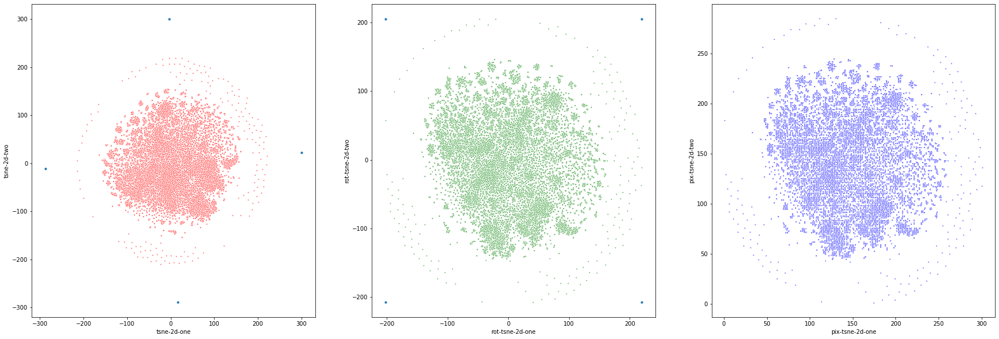

In [28]:
plt.figure(figsize=(30,10))
plt.subplot(131)
sns.scatterplot(x="tsne-2d-one", y="tsne-2d-two",data=df_subset,alpha=0.7,s=5,color='r')
plt.scatter(mbr[:,0], mbr[:,1],s=10)
plt.subplot(132)
sns.scatterplot(x="rot-tsne-2d-one", y="rot-tsne-2d-two",data=rz_subset,alpha=0.7,s=5,color='g')
plt.scatter(zrect[:,0], zrect[:,1],s=10)
plt.subplot(133)
sns.scatterplot(x="pix-tsne-2d-one", y="pix-tsne-2d-two",data=pix_subset,alpha=0.7,s=5,color='b')
#----------------------------------------------------------------------------------------------------------------
#plt.scatter(zrect_pix_subset.values[:,0], zrect_pix_subset.values[:,1],s=10)
#sns.scatterplot(data=z,alpha# =0.9,s=5,color='r')
#plt.axis('equal')
#---------------------------umap
# plt.figure(figsize=(30,10))
# plt.subplot(131)
# sns.scatterplot(x="umap-2d-one", y="umap-2d-two",data=df_subset,alpha=0.7,s=5,color='r')
# plt.scatter(mbr[:,0], mbr[:,1],s=10)
# plt.subplot(132)
# sns.scatterplot(x="rot-umap-2d-one", y="rot-umap-2d-two",data=rz_subset,alpha=0.7,s=5,color='g')
# plt.scatter(zrect[:,0], zrect[:,1],s=10)
# plt.subplot(133)
# sns.scatterplot(x="pix-umap-2d-one", y="pix-umap-2d-two",data=pix_subset,alpha=0.7,s=5,color='b')

In [29]:
new_A = max(round_x_pixel)
new_B = max(round_y_pixel)
new_A,new_B

(301, 285)

In [30]:
maxAB = max(new_A,new_B)
maxAB
#------------------------------- cart2pixel completed

301

In [31]:
#------------------------------- conv2pixel started
M = np.ones((new_A,new_B))
M
# #-testing square image
# sqM = np.ones((maxAB,maxAB))

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

In [ ]:
# N = np.zeros((new_A,new_B))
# plt.imshow(N, cmap="gray", vmin=0, vmax=1)

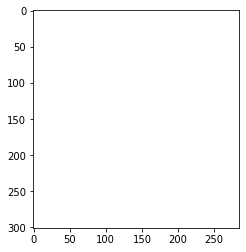

In [32]:
plt.imshow(M, cmap="afmhot", vmin=0, vmax=1)
#plt.imshow(sqM, cmap="afmhot", vmin=0, vmax=1)

In [ ]:
# test_im = np.random.rand(new_A,new_B)
# plt.imshow(test_im, cmap='summer',vmin=0, vmax=1)

In [33]:
#loads the data to map on the locations
data = pd.read_csv("mRna_sorted_out.csv")

In [34]:
#data.head()
clean_data = data.iloc[:,1:]
#type(clean_data)

In [35]:
mmscaler = MinMaxScaler()
mmscaler.fit(clean_data)
print(mmscaler.data_max_)
print(mmscaler.data_min_)
norm_data = pd.DataFrame(mmscaler.transform(clean_data))

[3.96893887 6.34411785 4.57960861 ... 6.20543584 2.79062673 4.48253108]
[-3.57847416 -0.35598304 -0.52927637 ... -3.25935091 -2.14908878
 -0.33378014]


In [36]:
norm_data.shape[0]

294

In [38]:
sample_no = 0
fvec = norm_data.iloc[sample_no,:]
fvec

0        0.516605
1        0.000000
2        0.000000
3        0.533002
4        0.000000
           ...   
20167    0.569519
20168    0.823282
20169    0.377055
20170    0.734191
20171    0.000000
Name: 0, Length: 20172, dtype: float64

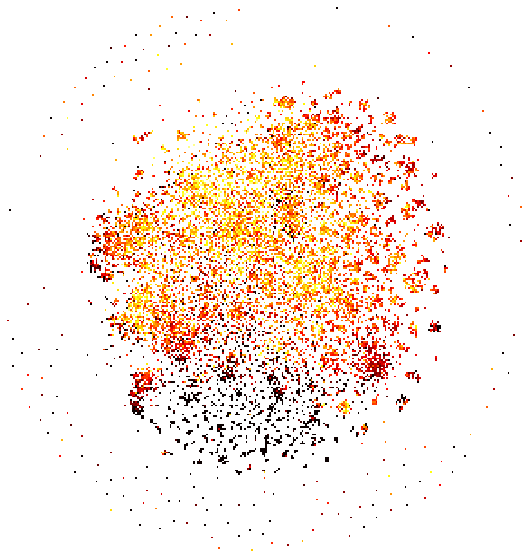

In [40]:
for i in range(len(fvec)):
    M[round_x_pixel[i]-1,round_y_pixel[i]-1] = fvec[i]
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(M, cmap='hot',vmin=0, vmax=1)
#plt.imsave('images/sample_no_test_' + str(sample_no )  + '.jpg', cmap='afmhot',arr=M, dpi=1200)
#

In [41]:
# for i in range(norm_data.shape[0]):
#     sample_no = i
#     imgM = np.ones((new_A,new_B))
#     fvec = norm_data.iloc[sample_no,:]
#     for j in range(norm_data.shape[1]):
#         imgM[round_x_pixel[j]-1,round_y_pixel[j]-1] = fvec[j]
#     plt.figure(figsize=(10,10))
#     plt.axis('off')
#     plt.imshow(imgM, cmap='hot',vmin=0, vmax=1)
#     plt.savefig('images/tsne_perp3cosine_sample_no_' + str(sample_no )  + '.png',bbox_inches='tight', dpi=1200)
#     plt.close()
#     #break
#     #plt.imsave('images/sample_no_' + str(sample_no)  + '.png', cmap='afmhot',arr=imgM, dpi=2000)